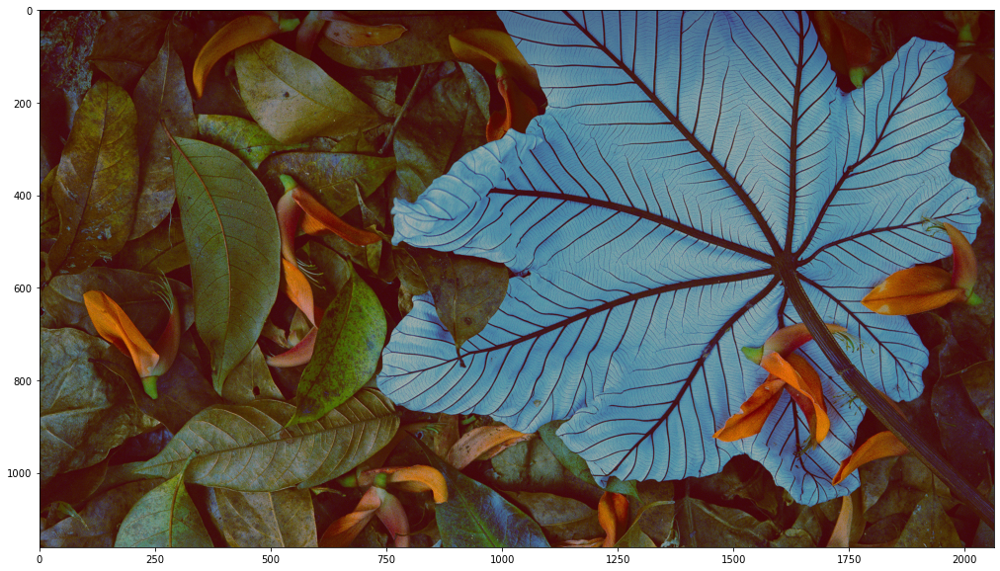

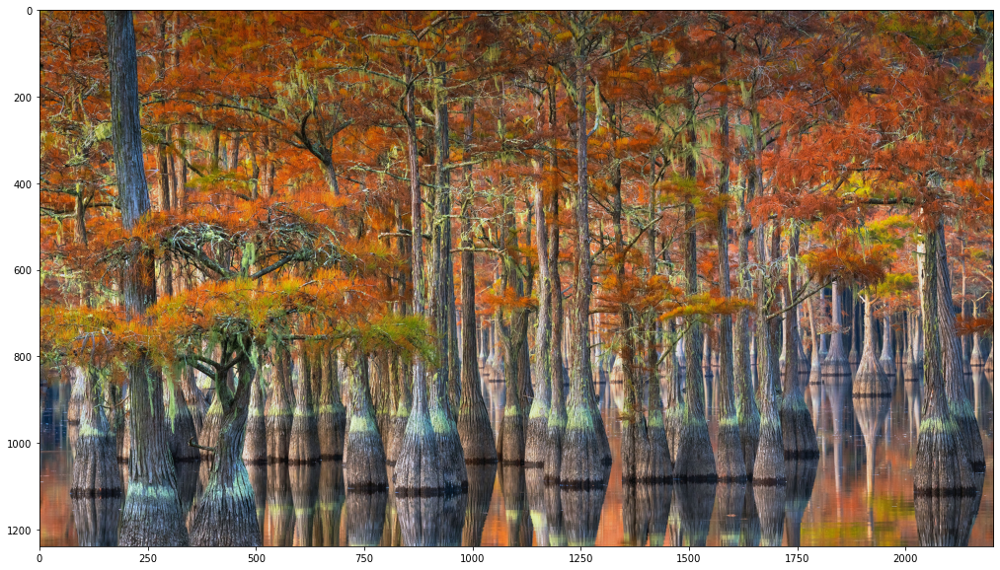

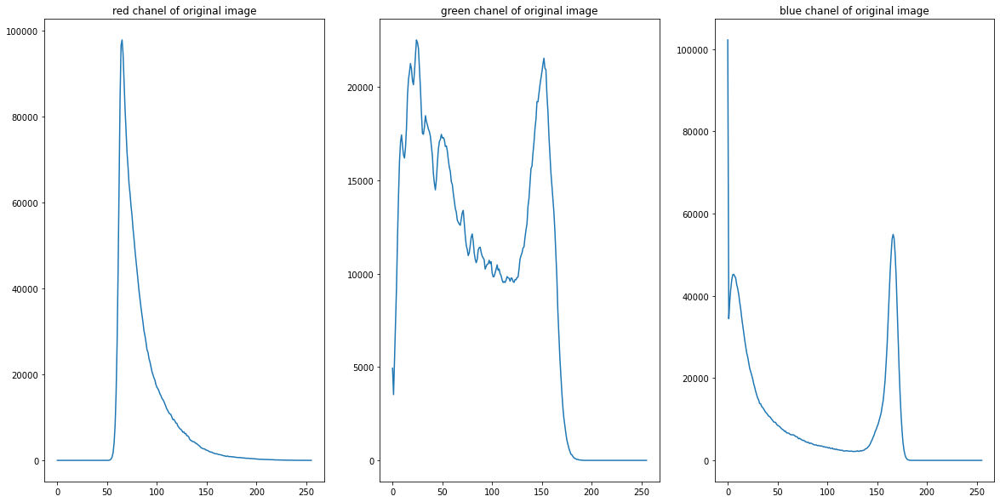

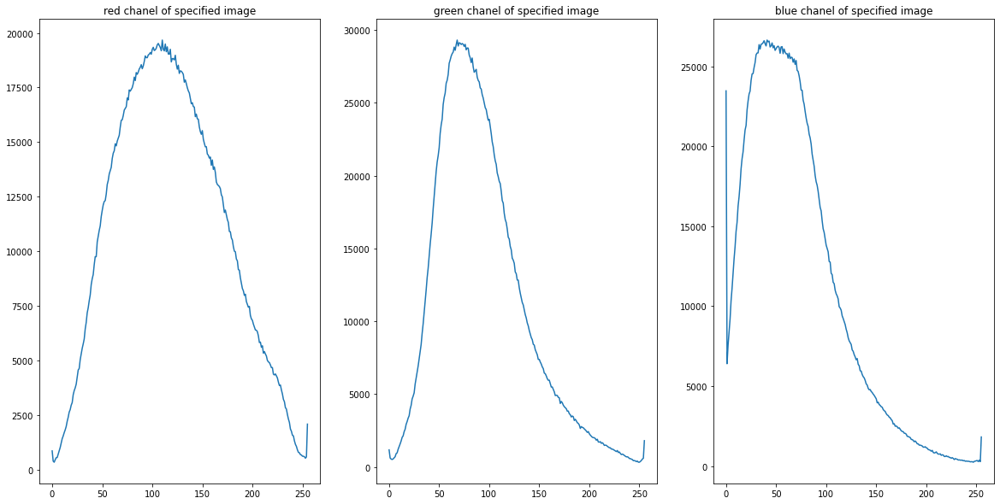

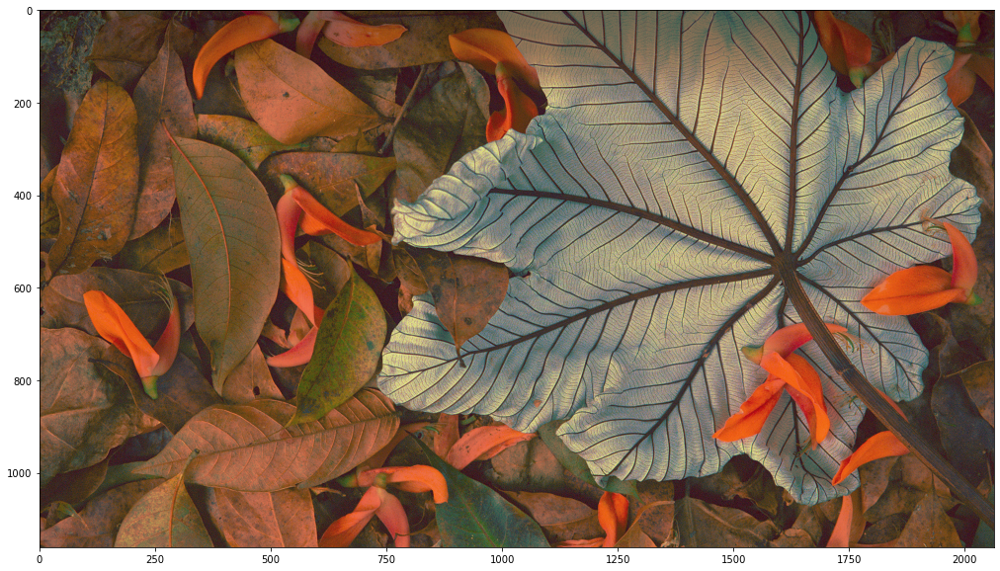

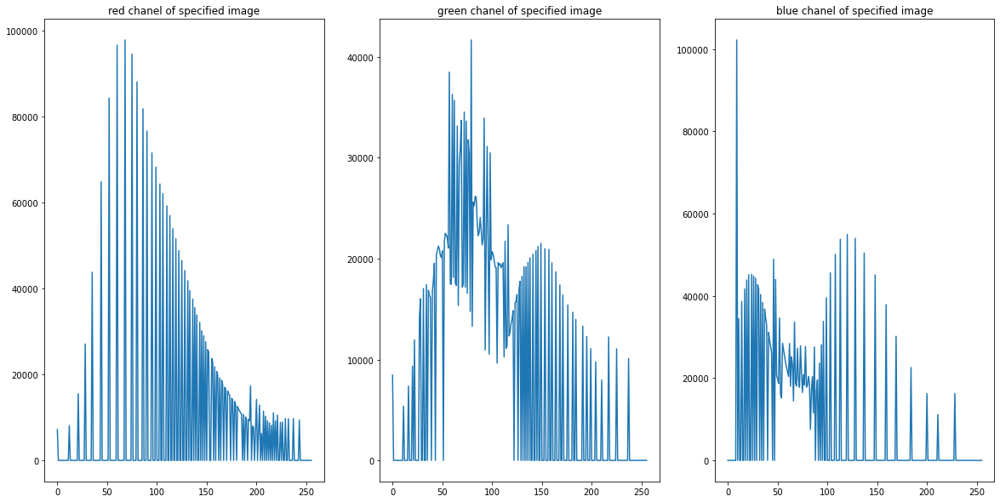

True

In [100]:
# https://automaticaddison.com/difference-between-histogram-equalization-and-histogram-matching/

# Q1-1
import numpy as np
import matplotlib.pyplot as plt
import cv2
from collections import Counter

# Create histogram of an image with this function
def creat_histogram(image):    
    resolution = 256
    counter = dict(Counter(image.ravel()))
    indices = np.array(list(counter.keys()))
    val = np.array(list(counter.values()))
    image_hist = np.zeros(resolution)
    image_hist[indices] = val
    return image_hist

# Function for Histogram matching between original image and specified image
def histogram_matching(original_hist, specified_hist):
    resolution = 255
    original_cdf = np.floor(resolution * np.cumsum(original_hist) / np.sum(original_hist))
    specified_cdf = np.floor(resolution * np.cumsum(specified_hist) / np.sum(specified_hist))
    x, y = np.meshgrid(original_cdf, specified_cdf)
    mapping = np.argmin(np.abs(x - y), axis=0)
    return mapping

# Reading our images
image_original = cv2.imread('Cecropia.jpg')
image_original = cv2.cvtColor(image_original, cv2.COLOR_BGR2RGB)
plt.imshow(image_original)
plt.show()

plt.figure()
image_specified = cv2.imread('GeorgiaCypress.jpg')
image_specified = cv2.cvtColor(image_specified, cv2.COLOR_BGR2RGB)
plt.imshow(image_specified)
plt.show()

# Creat our histograms with our functino
image_original_r_hist = creat_histogram(image_original[:, :, 0])
image_original_g_hist = creat_histogram(image_original[:, :, 1])
image_original_b_hist = creat_histogram(image_original[:, :, 2])

image_specified_r_hist = creat_histogram(image_specified[:, :, 0])
image_specified_g_hist = creat_histogram(image_specified[:, :, 1])
image_specified_b_hist = creat_histogram(image_specified[:, :, 2])

# Showing our histograms 
fig, axs = plt.subplots(1, 3)
axs[0].plot(image_original_r_hist)
axs[0].set_title("red chanel of original image")
axs[1].plot(image_original_g_hist)
axs[1].set_title("green chanel of original image")
axs[2].plot(image_original_b_hist)
axs[2].set_title("blue chanel of original image")
plt.show()

fig, axs = plt.subplots(1, 3)
axs[0].plot(image_specified_r_hist)
axs[0].set_title("red chanel of specified image")
axs[1].plot(image_specified_g_hist)
axs[1].set_title("green chanel of specified image")
axs[2].plot(image_specified_b_hist)
axs[2].set_title("blue chanel of specified image")
plt.show()

# Creating right mapping for pixels of original image
final_image_r_mapping = histogram_matching(image_original_r_hist, image_specified_r_hist)
final_image_g_mapping = histogram_matching(image_original_g_hist, image_specified_g_hist)
final_image_b_mapping = histogram_matching(image_original_b_hist, image_specified_b_hist)

# Creating our final image chanels
final_image_r_chanel = final_image_r_mapping[image_original[:, :, 0]]
final_image_g_chanel = final_image_g_mapping[image_original[:, :, 1]]
final_image_b_chanel = final_image_b_mapping[image_original[:, :, 2]]

# Concatinating these 3 channls
final_image_r_chanel = final_image_r_chanel.reshape(image_original.shape[0], image_original.shape[1], 1)
final_image_g_chanel = final_image_g_chanel.reshape(image_original.shape[0], image_original.shape[1], 1)
final_image_b_chanel = final_image_b_chanel.reshape(image_original.shape[0], image_original.shape[1], 1)
final_image = np.concatenate((final_image_r_chanel, final_image_g_chanel, final_image_b_chanel), axis=2)

# Showing result
plt.imshow(final_image)
plt.show()

# Creating histogram for final image
image_final_r_hist = creat_histogram(final_image[:, :, 0])
image_final_g_hist = creat_histogram(final_image[:, :, 1])
image_final_b_hist = creat_histogram(final_image[:, :, 2])

# Showing histogram of final image
fig, axs = plt.subplots(1, 3)
axs[0].plot(image_final_r_hist)
axs[0].set_title("red chanel of specified image")
axs[1].plot(image_final_g_hist)
axs[1].set_title("green chanel of specified image")
axs[2].plot(image_final_b_hist)
axs[2].set_title("blue chanel of specified image")
plt.show()

# Saving our result 
fig.savefig('result_01.jpg')
result_02 = np.concatenate((final_image_b_chanel, final_image_g_chanel, final_image_r_chanel), axis=2)
cv2.imwrite('result_02.jpg', result_02)


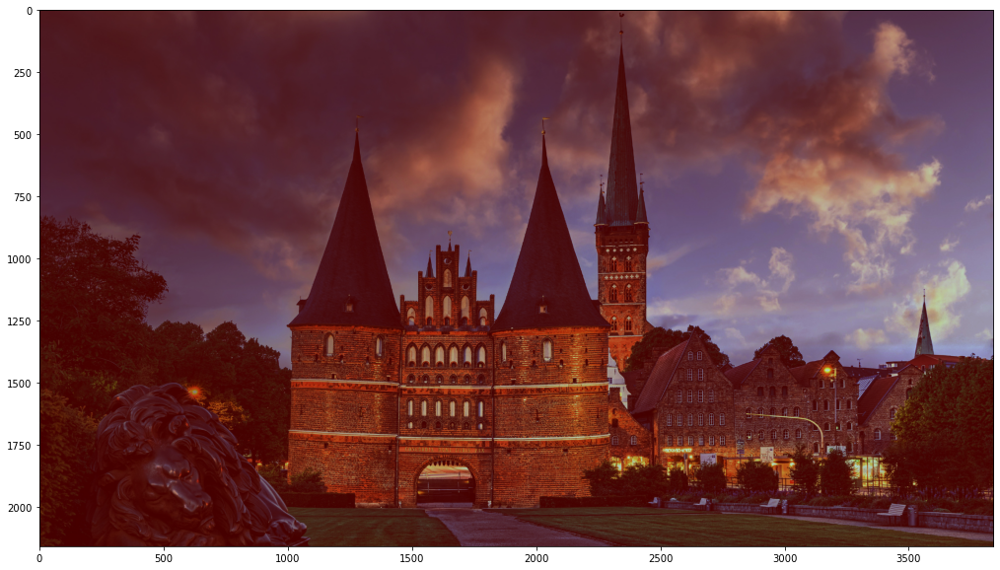

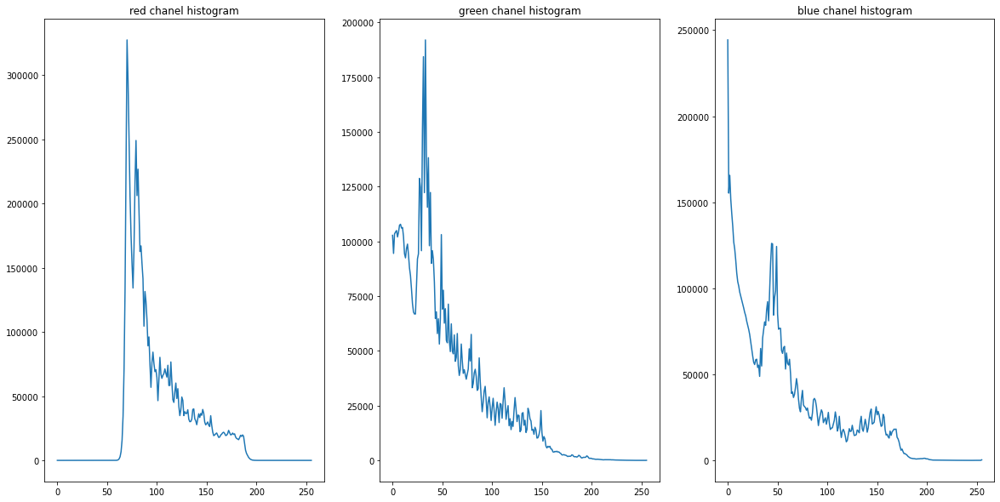

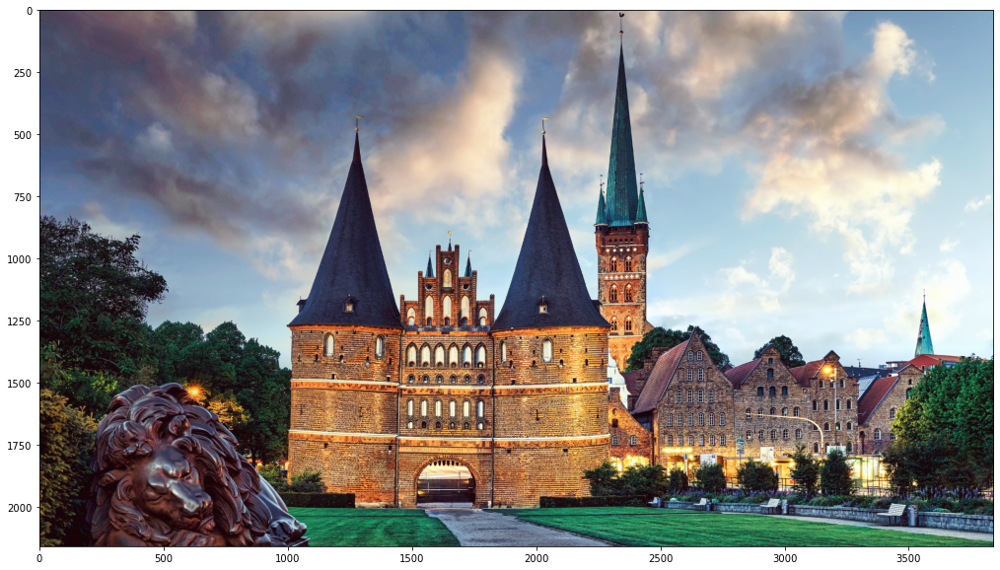

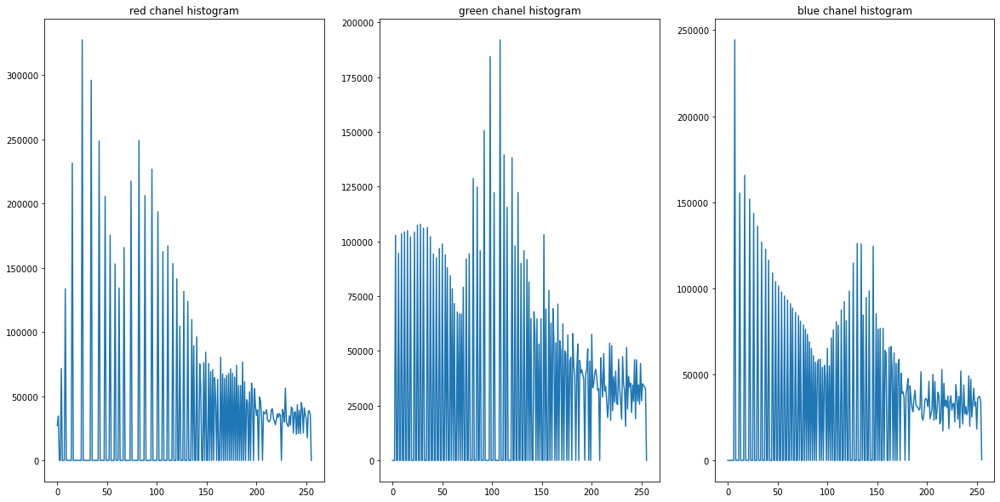

True

In [105]:
# q1-2
import numpy as np
import cv2
import matplotlib.pyplot as plt
from collections import Counter

# Create histogram of an image with this function
def creat_histogram(image):    
    resolution = 256
    counter = dict(Counter(image.ravel()))
    indices = np.array(list(counter.keys()))
    val = np.array(list(counter.values()))
    image_hist = np.zeros(resolution)
    image_hist[indices] = val
    return image_hist

# This function calculate the best mapping for histogram equalization
def histogram_equalization(image_hist):
    resolution = 255
    image_mapping = np.floor(resolution * np.cumsum(image_hist) / np.sum(image_hist)).astype(int)
    return image_mapping

# Read our image
image = cv2.imread('LuebeckCityGate.jpg')
image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
plt.imshow(image)
plt.show()

# Calculate 3 channels hsitogram of our image
image_r_hist = creat_histogram(image[:, :, 0])
image_g_hist = creat_histogram(image[:, :, 1])
image_b_hist = creat_histogram(image[:, :, 2])

# Showing histograms 
fig, axs = plt.subplots(1, 3)
axs[0].plot(image_r_hist)
axs[0].set_title("red chanel histogram")
axs[1].plot(image_g_hist)
axs[1].set_title("green chanel histogram")
axs[2].plot(image_b_hist)
axs[2].set_title("blue chanel histogram")
plt.show()

# Using histogram_equalization() to find the mapping for this part of assignment
image_r_mapping = histogram_equalization(image_r_hist)
image_g_mapping = histogram_equalization(image_g_hist)
image_b_mapping = histogram_equalization(image_b_hist)

# Apply mapping to 3 channels seperately
image_r_chanel = image_r_mapping[image[:, :, 0]]
image_g_chanel = image_g_mapping[image[:, :, 1]]
image_b_chanel = image_b_mapping[image[:, :, 2]]

# Concatenate 3 channels to create a unit image
image_r_chanel = image_r_chanel.reshape(image.shape[0], image.shape[1], 1)
image_g_chanel = image_g_chanel.reshape(image.shape[0], image.shape[1], 1)
image_b_chanel = image_b_chanel.reshape(image.shape[0], image.shape[1], 1)
final_image = np.concatenate((image_r_chanel, image_g_chanel, image_b_chanel), axis=2)

# Showing result
plt.figure()
plt.imshow(final_image)
plt.show()

# Create histograms for final image
final_r_hist = creat_histogram(final_image[:, :, 0])
final_g_hist = creat_histogram(final_image[:, :, 1])
final_b_hist = creat_histogram(final_image[:, :, 2])

# Showing histograms 
fig, axs = plt.subplots(1, 3)
axs[0].plot(final_r_hist)
axs[0].set_title("red chanel histogram")
axs[1].plot(final_g_hist)
axs[1].set_title("green chanel histogram")
axs[2].plot(final_b_hist)
axs[2].set_title("blue chanel histogram")
plt.show()

# Saving our result
fig.savefig('result_03.jpg')
result_04 = np.concatenate((image_b_chanel, image_g_chanel, image_r_chanel), axis=2)
cv2.imwrite('result_04.jpg', result_04)

In [1]:
import numpy as np
import matplotlib.pyplot as plt
import cv2
import skimage.io as skio
plt.rcParams['figure.figsize'] = (20, 10)

In [145]:
def find_shifting(chanel_1, chanel_2, x_lim=(-20, 150), y_lim=(0, 100), step=4, last_process='ON'):
    '''
    chanel_1 is reference and find proper x_ and y_ shifting to set chanel_2 to chanel_1
    '''
    
    # crop from center of chanel_1 and chanel_2 to reduce our computation time
    resolution_divider = 8
    height = chanel_1.shape[0]
    width = chanel_1.shape[1]
    
    # set the boundary of x_range and y_range for moving chanel to in chanel 1
    x_boundary = range(x_lim[0], x_lim[1], step)
    y_boundary = range(y_lim[0], y_lim[1], step)
    
    # define shift score list
    shift_score_current = [(i, j) for i in x_boundary for j in y_boundary]
    shift_score_current = np.array(shift_score_current)
    
    # main body : 
    while resolution_divider > 1:
        
        # crop image depend on resolution divider
        x1 = int((0.5 - 0.5 / resolution_divider) * height)
        x2 = int((0.5 + 0.5 / resolution_divider) * height)
        y1 = int((0.5 - 0.5 / resolution_divider) * width)
        y2 = int((0.5 + 0.5 / resolution_divider) * width)
        c_1 = chanel_1[x1:x2, y1:y2]
        c_2 = chanel_2[x1:x2, y1:y2]
        
        # just do computing in center of our channels
        height_1 = c_1.shape[0]
        width_1 = c_1.shape[1]
        x_1 = int(0.25 * height_1)
        x_2 = int(0.75 * height_1)
        y_1 = int(0.25 * width_1)
        y_2 = int(0.75 * width_1)
        c1 = c_1[x_1:x_2, y_1:y_2]
        
        # do our process for resolution divider : [8, 4, 2]
        shift_score_new = []
        for i in range(shift_score_current.shape[0]):
            x = int(shift_score_current[i, 0])
            y = int(shift_score_current[i, 1])
            img = np.roll(c_2, (x, y), axis=(0, 1))
            img = img[x_1:x_2, y_1:y_2]
            
            # calculate score of every shifting
            score = np.sum((c1 - img) ** 4)
            my_tuple = (x, y, score)
            shift_score_new.append(my_tuple)
        shift_score_new = np.array(shift_score_new)
        shift_score_new = shift_score_new[shift_score_new[:, 2].argsort()]
        
        # printting result
        print('resolution divider : ', resolution_divider)
        print('shape of shift score : ', shift_score_new.shape)
        
        # ready to go to next step
        my_len = int(np.ceil(shift_score_new.shape[0] / 4))
        shift_score_current = shift_score_new[:my_len, :]
        resolution_divider /= 2

        # printting result
        print('chanel 1 size : ', c_1.shape)
        print('chanel 2 size : ', c_2.shape)    
        print('the best shifting is : ', shift_score_new[0, :])
        print('==========================================')
        
    # mode last_process to set the best possible one.
    if last_process == 'ON':
        my_len = int(np.ceil(shift_score_new.shape[0] / (step-1) ** 2))
        shift_score_new = shift_score_new[:my_len, :]
        shift_score_current = shift_score_new
        shift_score_new = []
        for i in range(shift_score_current.shape[0]):
            x = int(shift_score_current[i, 0])
            y = int(shift_score_current[i, 1])
            for j in range(1, step):
                for k in range(1, step):
                    x1 = x + j
                    y1 = y + k
                    img = np.roll(c_2, (x1, y1), axis=(0, 1))
                    img = img[x_1:x_2, y_1:y_2]
                    score = np.sum((c1 - img) ** 4)
                    my_tuple = (x1, y1, score)
                    shift_score_new.append(my_tuple)
        shift_score_new = np.array(shift_score_new)
        shift_score_new = shift_score_new[shift_score_new[:, 2].argsort()]
        print('last process mode is "on" and shape of shift score : ', shift_score_new.shape)
        print('the best shifting is : ', shift_score_new[0, :])
        print('==========================================')
                
    return shift_score_new[0, :2]

resolution divider :  8
shape of shift score :  (200, 3)
chanel 1 size :  (401, 464)
chanel 2 size :  (401, 464)
the best shifting is :  [-1.20000000e+01  1.00000000e+01  1.60517535e+12]
resolution divider :  4.0
shape of shift score :  (50, 3)
chanel 1 size :  (801, 928)
chanel 2 size :  (801, 928)
the best shifting is :  [-1.20000000e+01  1.00000000e+01  6.02913629e+12]
resolution divider :  2.0
shape of shift score :  (13, 3)
chanel 1 size :  (1601, 1856)
chanel 2 size :  (1601, 1856)
the best shifting is :  [-1.4000000e+01  1.0000000e+01  1.7155791e+13]
last process mode is "on" and shape of shift score :  (13, 3)
the best shifting is :  [-1.50000000e+01  1.10000000e+01  1.75198064e+13]
the best shifting for green chanel to set to blue one is :  [-15  11]
resolution divider :  8
shape of shift score :  (200, 3)
chanel 1 size :  (401, 464)
chanel 2 size :  (401, 464)
the best shifting is :  [1.40000000e+01 1.80000000e+01 7.36107112e+11]
resolution divider :  4.0
shape of shift score

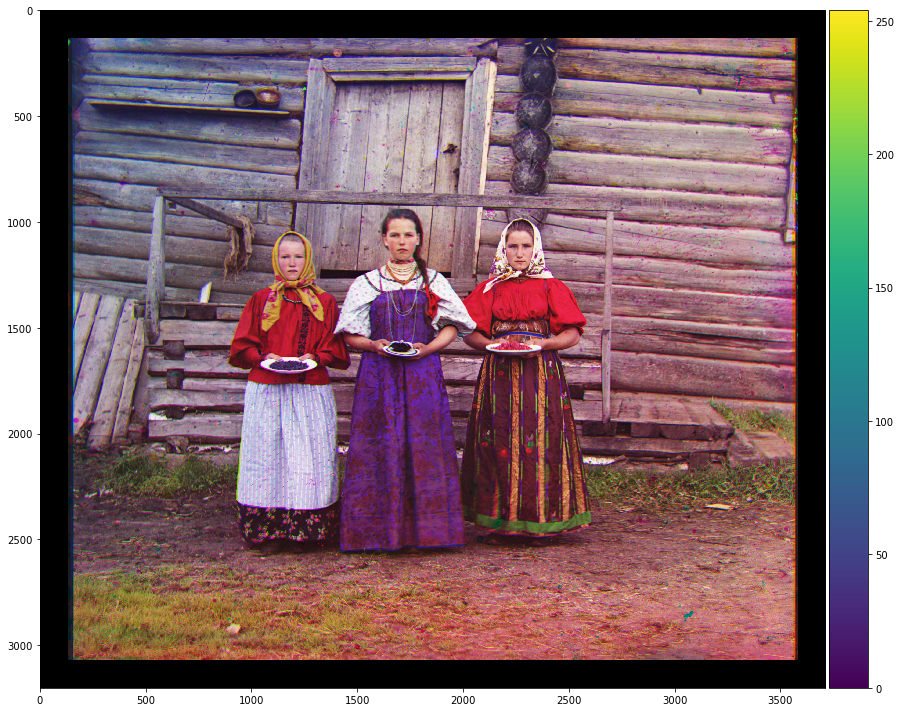

True

In [147]:
# read our image
image = cv2.imread('Girls.tif', 0)             # Girls : g : [-15, 10], r : [11, 15]
                                               # Train : g : [43, 0]  , r : [88, 30]
                                               # Museum : g : [78, 19], r : [149, 25]

# convert image type to float
image = image.astype(float)                  

# create our (r, g, b) channels
height = int(np.floor(image.shape[0] / 3))
image_b = image[:height]
image_g = image[height:2*height]
image_r = image[2*height:3*height]

# calculate best shiftting for green and red chanel
g_shift = find_shifting(image_b,
                        image_g,
                        x_lim=(-20, 20),
                        y_lim=(0, 20),
                        step=2,
                        last_process='ON').astype(int)
print('the best shifting for green chanel to set to blue one is : ', g_shift)
r_shift = find_shifting(image_b,
                        image_r,
                        x_lim=(-20, 20),
                        y_lim=(0, 20),
                        step=2,
                        last_process='ON').astype(int)
print('the best shifting for green chanel to set to blue one is : ', r_shift)

# shiftting our 2 channels
image_g_shifted = np.roll(image_g, g_shift, axis=(0, 1))
image_r_shifted = np.roll(image_r, r_shift, axis=(0, 1))

# concatenating 3 final channels to create an united image
image_final = np.dstack([image_r_shifted, image_g_shifted, image_b]).astype(int)
print(image_final.shape)

# crop margin not set boarders
my_len = 130
mask = np.ones((image_final.shape[0] - 2 * my_len, image_final.shape[1] - 2 * my_len, image_final.shape[2]))
mask = np.pad(mask , ((my_len, my_len), (my_len, my_len), (0, 0)))
image_final = (image_final * mask).astype(int)

# showing final image
skio.imshow(image_final)
skio.show()

# save our result
result_07 = np.float32(image_final)
result_07 = cv2.cvtColor(result_07, cv2.COLOR_RGB2BGR)
cv2.imwrite('Girls_result_07.jpg', result_07)

resolution divider :  8
shape of shift score :  (119, 3)
chanel 1 size :  (405, 468)
chanel 2 size :  (405, 468)
the best shifting is :  [4.20000000e+01 6.00000000e+00 1.81123945e+11]
resolution divider :  4.0
shape of shift score :  (29, 3)
chanel 1 size :  (809, 936)
chanel 2 size :  (809, 936)
the best shifting is :  [4.20000000e+01 6.00000000e+00 8.35163226e+11]
resolution divider :  2.0
shape of shift score :  (7, 3)
chanel 1 size :  (1619, 1870)
chanel 2 size :  (1619, 1870)
the best shifting is :  [4.20000000e+01 6.00000000e+00 5.37334935e+12]
last process mode is "on" and shape of shift score :  (25, 3)
the best shifting is :  [4.30000000e+01 7.00000000e+00 5.34901254e+12]
the best shifting for green chanel to set to blue one is :  [43  7]
resolution divider :  8
shape of shift score :  (119, 3)
chanel 1 size :  (405, 468)
chanel 2 size :  (405, 468)
the best shifting is :  [8.40000000e+01 3.00000000e+01 3.94578777e+11]
resolution divider :  4.0
shape of shift score :  (29, 3)


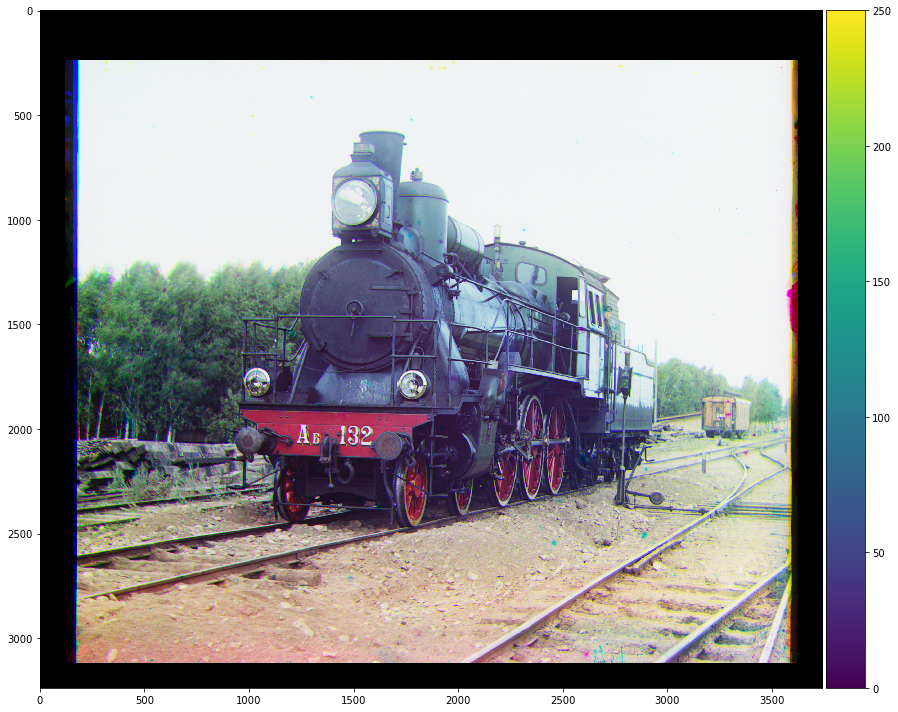

True

In [134]:
# read our image
image = cv2.imread('Train.tif', 0)             # Girls : g : [-15, 10], r : [11, 15]
                                               # Train : g : [43, 0]  , r : [88, 30]
                                               # Museum : g : [78, 19], r : [149, 25]

# convert image type to float
image = image.astype(float)                  

# create our (r, g, b) channels
height = int(np.floor(image.shape[0] / 3))
image_b = image[:height]
image_g = image[height:2*height]
image_r = image[2*height:3*height]

# calculate best shiftting for green and red chanel
g_shift = find_shifting(image_b,
                        image_g,
                        x_lim=(0, 100),
                        y_lim=(0, 40),
                        step=6,
                        last_process='ON').astype(int)
print('the best shifting for green chanel to set to blue one is : ', g_shift)
r_shift = find_shifting(image_b,
                        image_r,
                        x_lim=(0, 100),
                        y_lim=(0, 40),
                        step=6,
                        last_process='ON').astype(int)
print('the best shifting for green chanel to set to blue one is : ', r_shift)

# shiftting our 2 channels
image_g_shifted = np.roll(image_g, g_shift, axis=(0, 1))
image_r_shifted = np.roll(image_r, r_shift, axis=(0, 1))

# concatenating 3 final channels to create an united image
image_final = np.dstack([image_r_shifted, image_g_shifted, image_b]).astype(int)
print(image_final.shape)

# crop margin not set boarders
my_len = 120
mask = np.ones((image_final.shape[0] - 3 * my_len, image_final.shape[1] - 2 * my_len, image_final.shape[2]))
mask = np.pad(mask , ((2 * my_len, my_len), (my_len, my_len), (0, 0)))
image_final = (image_final * mask).astype(int)

# showing final image
skio.imshow(image_final)
skio.show()

# save our result
result_06 = np.float32(image_final)
result_06 = cv2.cvtColor(result_06, cv2.COLOR_RGB2BGR)
cv2.imwrite('Train_result_06.jpg', result_06)

resolution divider :  8
shape of shift score :  (125, 3)
chanel 1 size :  (409, 471)
chanel 2 size :  (409, 471)
the best shifting is :  [8.00000000e+01 1.80000000e+01 6.49734906e+11]
resolution divider :  4.0
shape of shift score :  (31, 3)
chanel 1 size :  (817, 943)
chanel 2 size :  (817, 943)
the best shifting is :  [8.00000000e+01 1.80000000e+01 1.92617509e+12]
resolution divider :  2.0
shape of shift score :  (7, 3)
chanel 1 size :  (1635, 1885)
chanel 2 size :  (1635, 1885)
the best shifting is :  [8.0000000e+01 1.8000000e+01 7.2152117e+12]
last process mode is "on" and shape of shift score :  (25, 3)
the best shifting is :  [8.10000000e+01 1.90000000e+01 7.50986509e+12]
the best shifting for green chanel to set to blue one is :  [81 19]
resolution divider :  8
shape of shift score :  (850, 3)
chanel 1 size :  (409, 471)
chanel 2 size :  (409, 471)
the best shifting is :  [1.52000000e+02 2.40000000e+01 9.88178975e+12]
resolution divider :  4.0
shape of shift score :  (212, 3)
ch

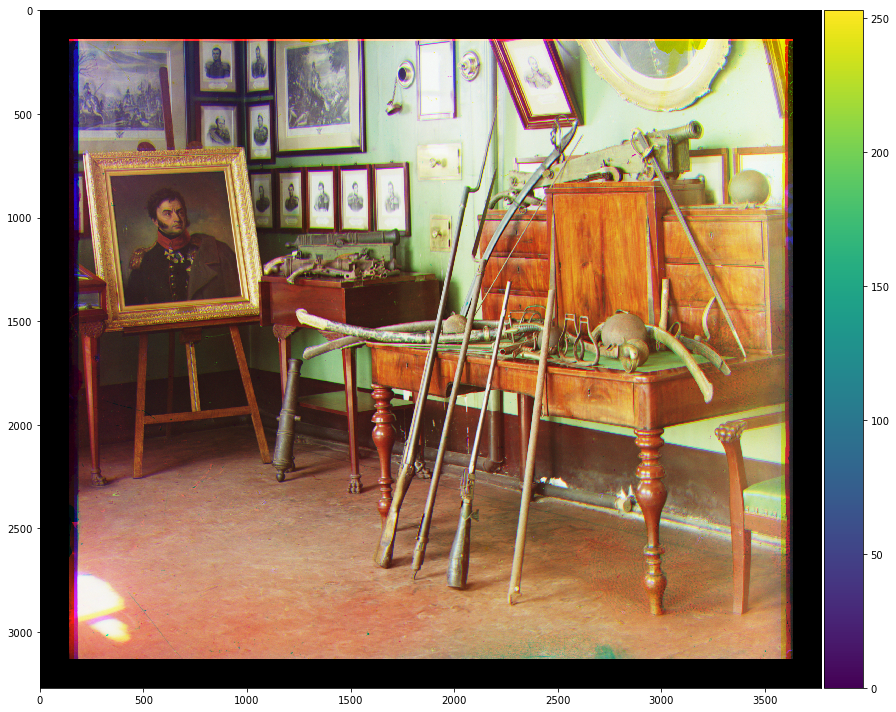

True

In [135]:
# read our image
image = cv2.imread('Museum.tif', 0)            # Girls : g : [-15, 10], r : [11, 15]
                                               # Train : g : [43, 0]  , r : [88, 30]
                                               # Museum : g : [78, 19], r : [149, 25]

# convert image type to float
image = image.astype(float)                  

# create our (r, g, b) channels
height = int(np.floor(image.shape[0] / 3))
image_b = image[:height]
image_g = image[height:2*height]
image_r = image[2*height:3*height]

# calculate best shiftting for green and red chanel
g_shift = find_shifting(image_b,
                        image_g,
                        x_lim=(50, 200),
                        y_lim=(0, 30),
                        step=6,
                        last_process='ON').astype(int)
print('the best shifting for green chanel to set to blue one is : ', g_shift)
r_shift = find_shifting(image_b,
                        image_r,
                        x_lim=(50, 200),
                        y_lim=(0, 200),
                        step=6,
                        last_process='ON').astype(int)
print('the best shifting for green chanel to set to blue one is : ', r_shift)

# shiftting our 2 channels
image_g_shifted = np.roll(image_g, g_shift, axis=(0, 1))
image_r_shifted = np.roll(image_r, r_shift, axis=(0, 1))

# concatenating 3 final channels to create an united image
image_final = np.dstack([image_r_shifted, image_g_shifted, image_b]).astype(int)
print('shape of final image : ', image_final.shape)

# crop margin not set boarders
my_len = 140
mask = np.ones((image_final.shape[0] - 2 * my_len, image_final.shape[1] - 2 * my_len, image_final.shape[2]))
mask = np.pad(mask , ((my_len, my_len), (my_len, my_len), (0, 0)))
image_final = (image_final * mask).astype(int)

# showing final image
skio.imshow(image_final)
skio.show()

# save our result
result_05 = np.float32(image_final)
result_05 = cv2.cvtColor(result_05, cv2.COLOR_RGB2BGR)
cv2.imwrite('Museum_result_05.jpg', result_05)

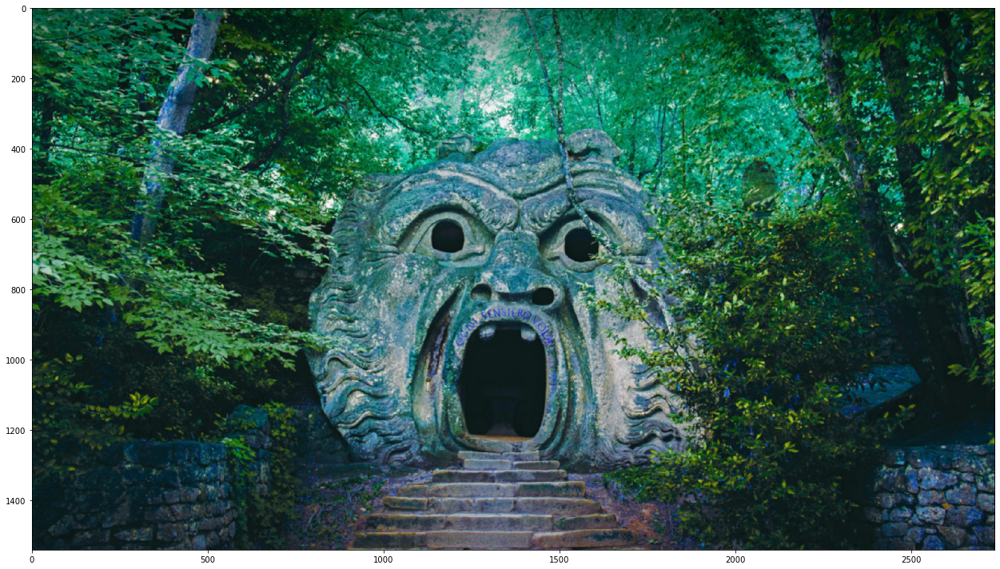

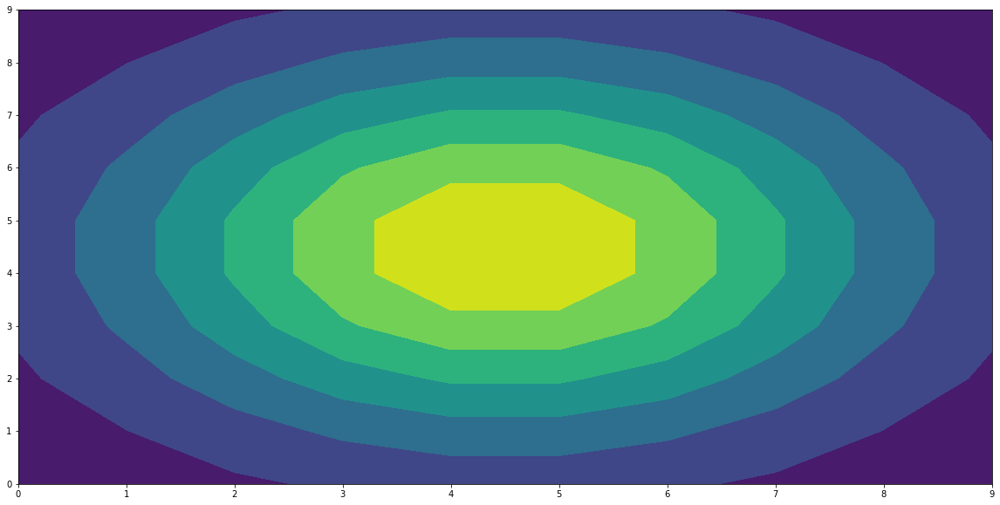

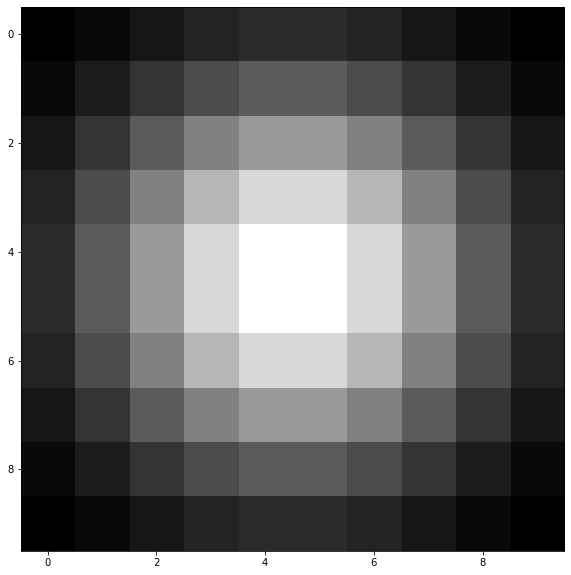

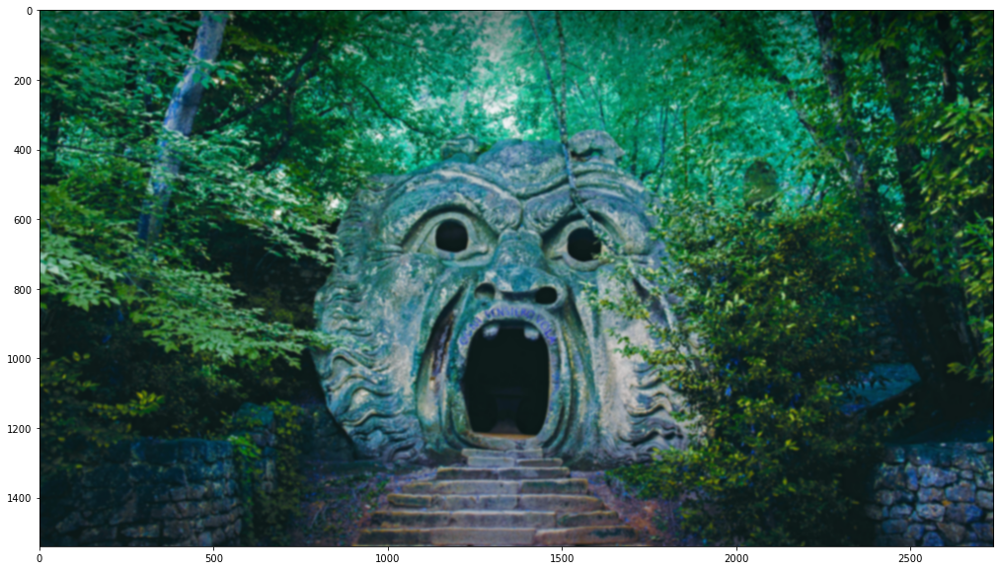

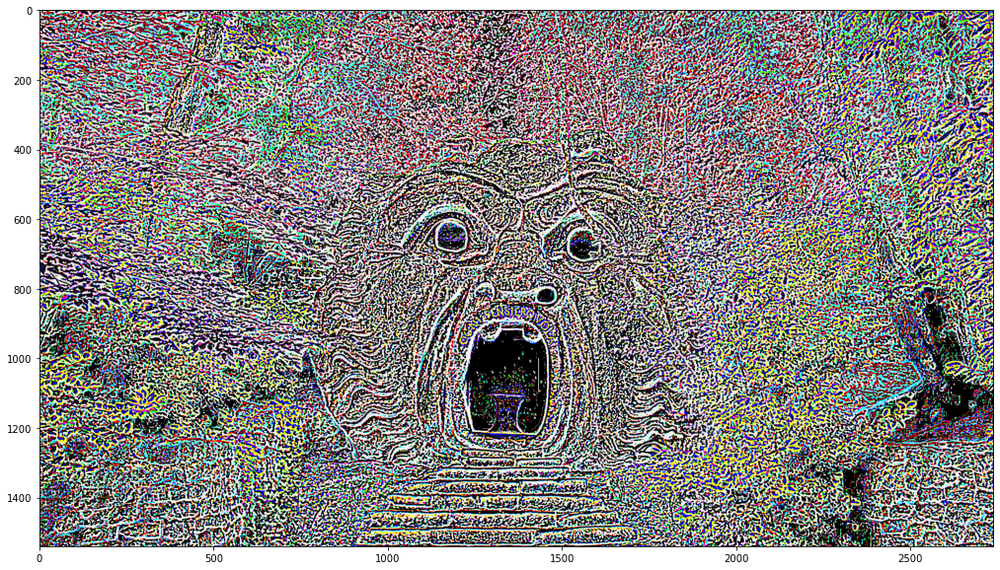

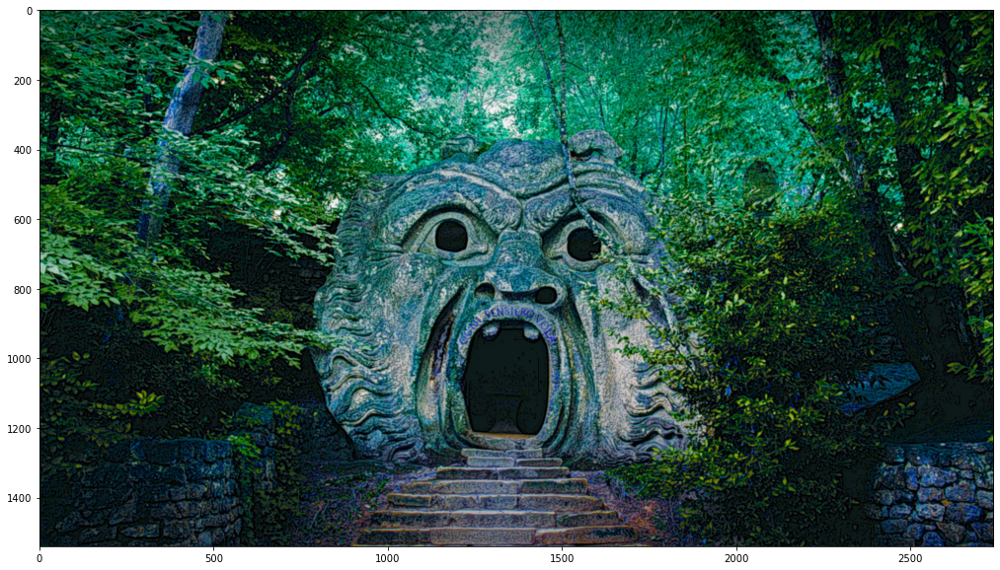

In [287]:
# import our needed libraries
import cv2 
import numpy as np
import matplotlib.pyplot as plt
import skimage.io as skio
plt.rcParams['figure.figsize'] = (20, 10)

# read our image
image = cv2.imread('OrcusMouth-blured.jpg')
skio.imshow(image)
plt.show()

# define our function
def gaussian_filter(kernel_width=3):
    sigma = kernel_width / 4
    miu = (kernel_width - 1) / 2
    x_axis, y_axis = np.meshgrid(range(kernel_width), range(kernel_width))
    kernel = np.exp(-((x_axis - miu) ** 2 + (y_axis - miu) ** 2) / (2 * sigma ** 2))
    kernel = kernel / np.sum(kernel) # Normalizing our filter 
    return x_axis, y_axis, kernel

# create our filter and show it
x, y, kernel = gaussian_filter(10)
plt.contourf(x, y, kernel)
plt.show()
fig = plt.figure()
plt.imshow(kernel, cmap='gray')
fig.savefig('result_08.jpg')
plt.show()

# Apply the filter and create blured image
image_blured = cv2.filter2D(src=image.copy(), ddepth=-1, kernel=kernel).astype(np.uint8)
plt.imshow(image_blured)
result_09 = np.float32(image_blured)
result_09 = cv2.cvtColor(result_09, cv2.COLOR_RGB2BGR)
cv2.imwrite('result_09.jpg', result_09)
plt.show()

# create shapening mask
image_unsharp = image.copy() - image_blured.copy()
plt.imshow(image_unsharp)
result_10 = np.float32(image_unsharp)
result_10 = cv2.cvtColor(result_10, cv2.COLOR_RGB2BGR)
cv2.imwrite('result_10.jpg', result_10)
plt.show()

# create sharpened image
alpha = 0.1
image_sharpened = image.copy() - alpha * image_unsharp
image_sharpened[image_sharpened < 0] = 0
image_sharpened[image_sharpened > 255] = 255
image_sharpened = image_sharpened.astype(np.uint8)
plt.imshow(image_sharpened)
result_11 = np.float32(image_sharpened)
result_11 = cv2.cvtColor(result_11, cv2.COLOR_RGB2BGR)
cv2.imwrite('result_11.jpg', result_11)
plt.show()

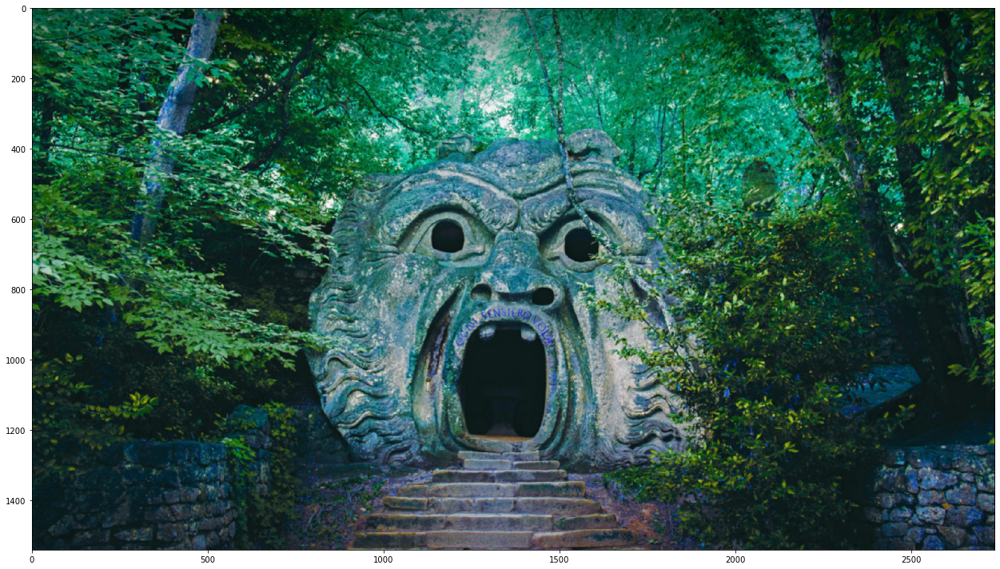

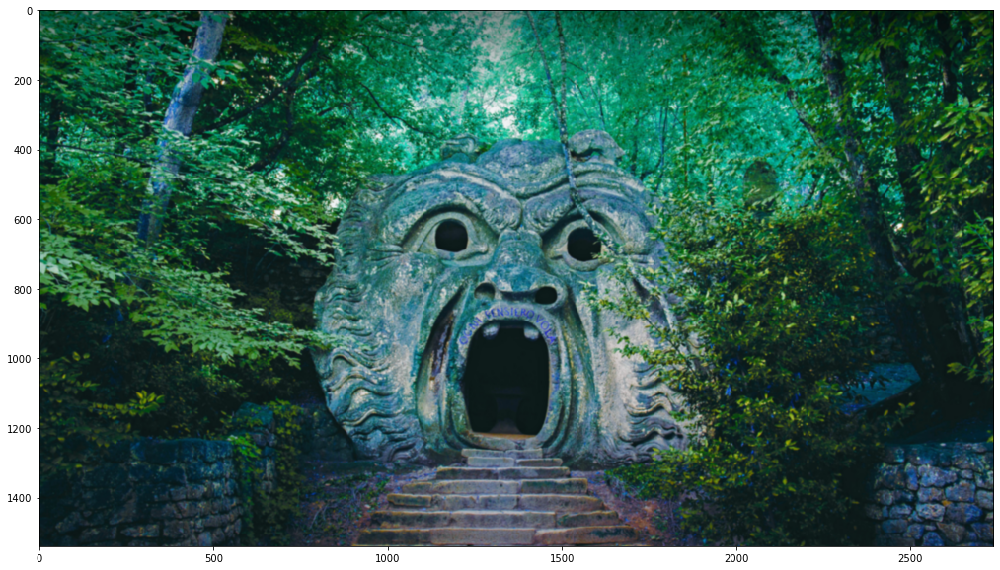

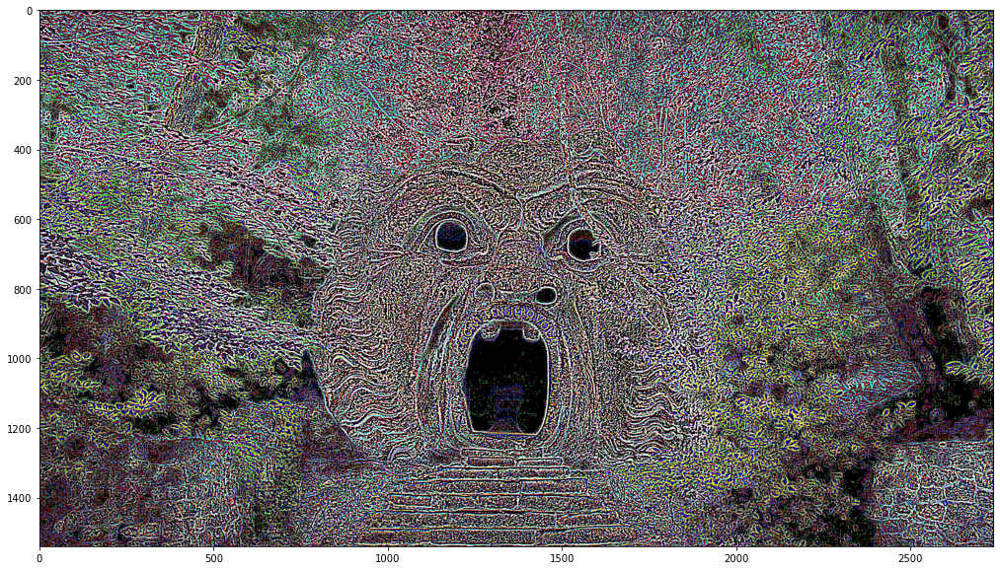

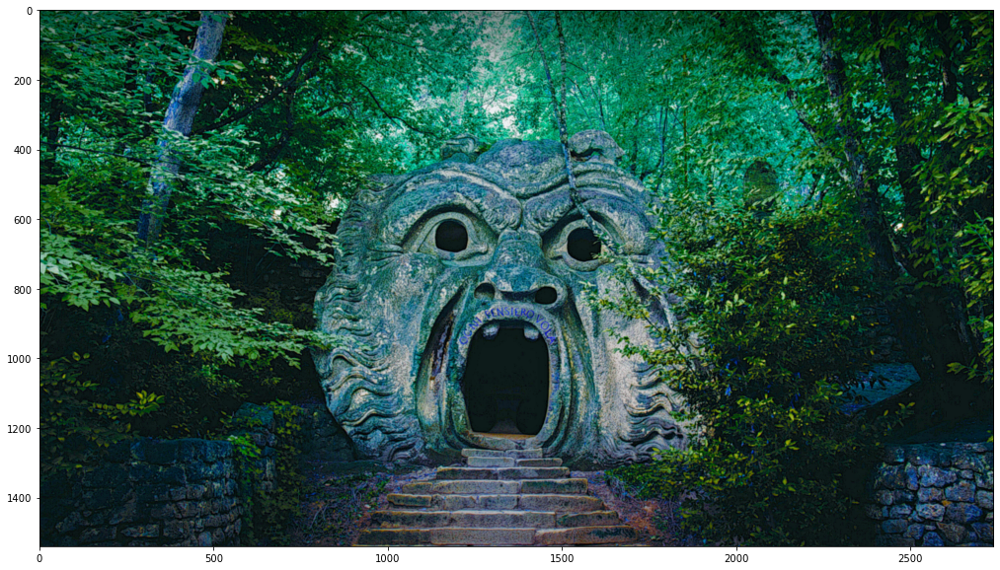

In [269]:
# import our needed libraries
import cv2 
import numpy as np
import matplotlib.pyplot as plt
import skimage.io as skio
plt.rcParams['figure.figsize'] = (20, 10)

# read our image
image = cv2.imread('OrcusMouth-blured.jpg')
skio.imshow(image)
plt.show()

# define our function
kernel_width = 3 
kernel = np.ones(shape=(kernel_width, kernel_width)) / (kernel_width ** 2)

# Apply the filter and create blured image
image_blured = cv2.filter2D(src=image.copy(), ddepth=-1, kernel=kernel).astype(np.uint8)
plt.imshow(image_blured)
result_12 = np.float32(image_blured)
result_12 = cv2.cvtColor(result_12, cv2.COLOR_RGB2BGR)
cv2.imwrite('result_12.jpg', result_12)
plt.show()

# create shapening mask
image_unsharp = image.copy() - image_blured.copy()
plt.imshow(image_unsharp)
result_13 = np.float32(image_unsharp)
result_13 = cv2.cvtColor(result_13, cv2.COLOR_RGB2BGR)
cv2.imwrite('result_13.jpg', result_13)
plt.show()

# create sharpened image
alpha = 0.1
image_sharpened = image.copy() - alpha * image_unsharp
image_sharpened[image_sharpened < 0] = 0
image_sharpened[image_sharpened > 255] = 255
image_sharpened = image_sharpened.astype(np.uint8)
plt.imshow(image_sharpened)
result_14 = np.float32(image_sharpened)
result_14 = cv2.cvtColor(result_14, cv2.COLOR_RGB2BGR)
cv2.imwrite('result_14.jpg', result_14)
plt.show()

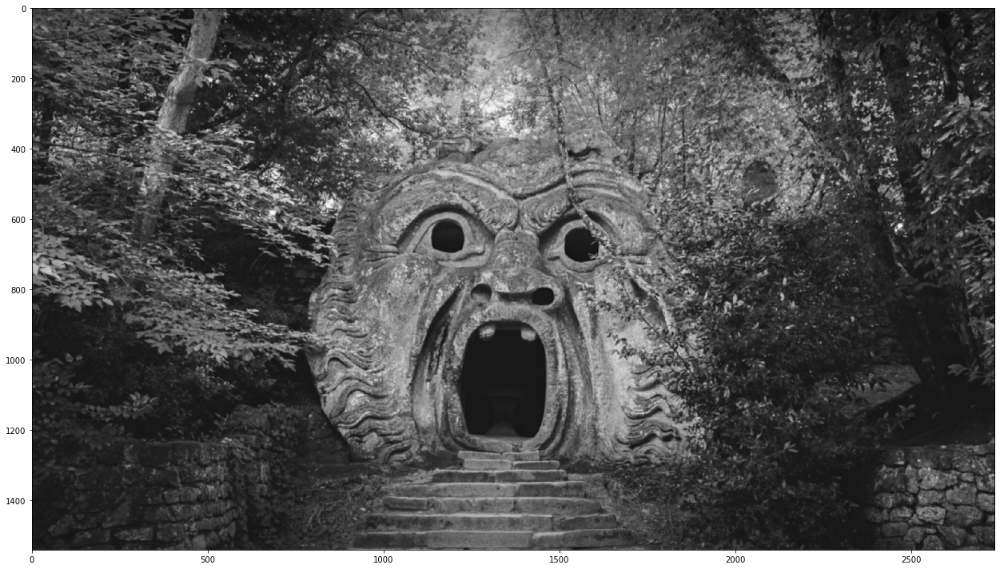

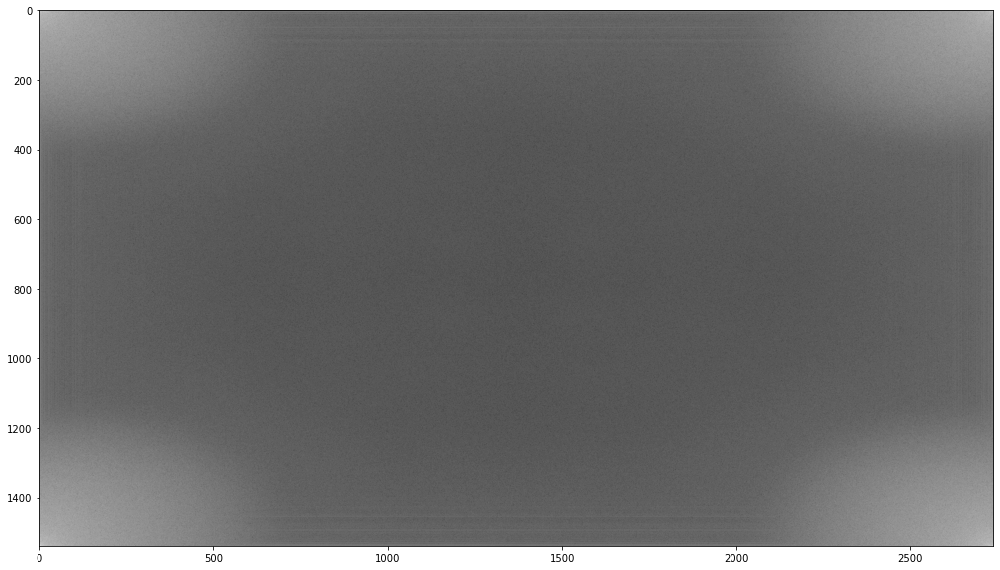

/tmp/ipykernel_2915/1951983126.py:28: DeprecationWarning: `np.float` is a deprecated alias for the builtin `float`. To silence this warning, use `float` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.float64` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  filter_HP = np.zeros(image.shape, np.float)


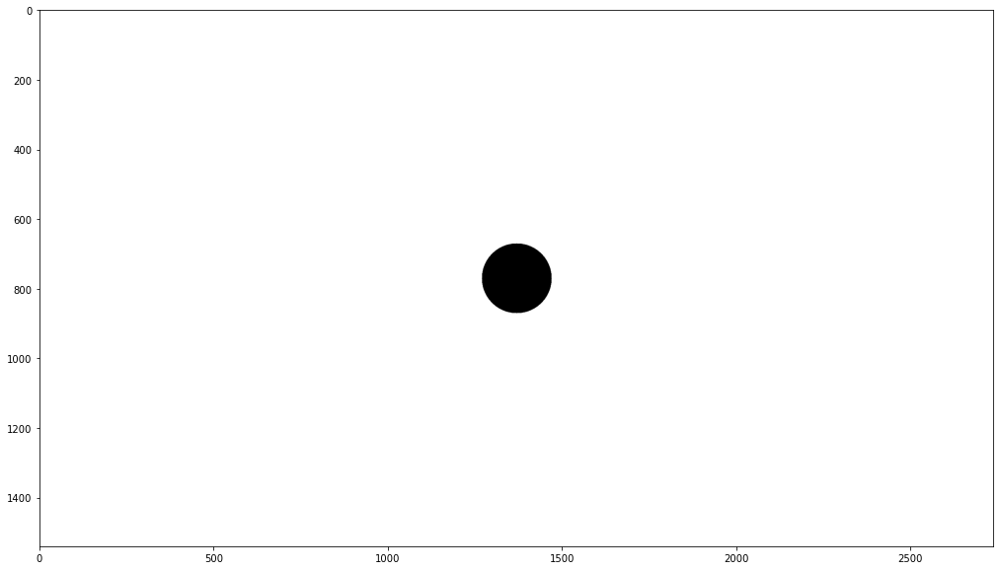

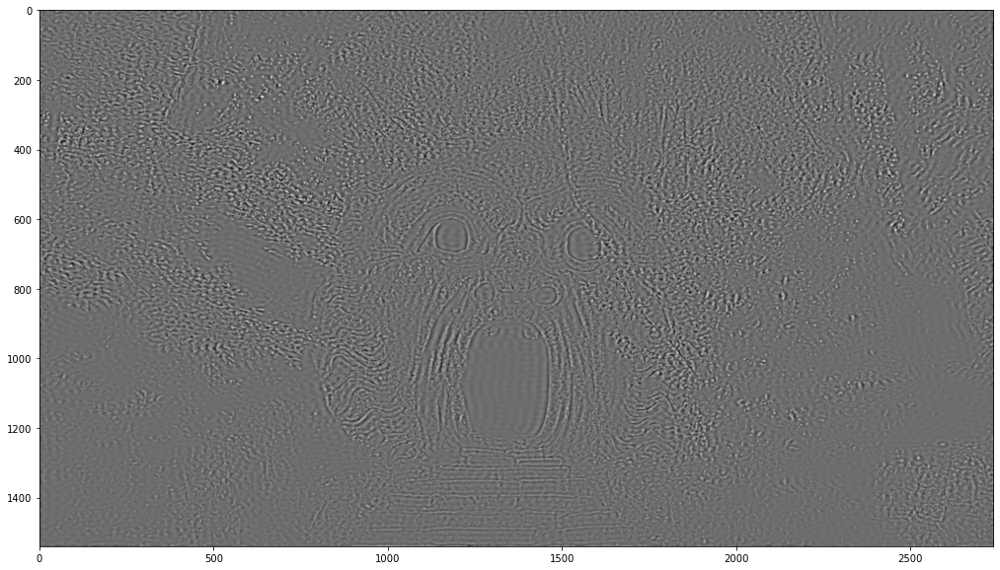

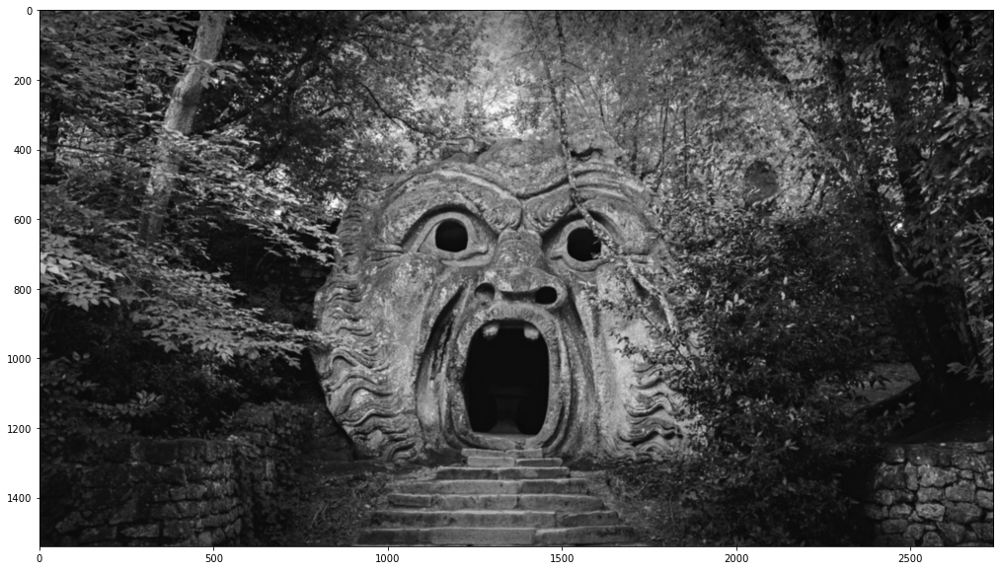

In [285]:
# import our needed libraries
import cv2 
import numpy as np
import matplotlib.pyplot as plt
import skimage.io as skio
plt.rcParams['figure.figsize'] = (20, 10)

# read our image
image = cv2.imread('OrcusMouth-blured.jpg')
image = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
skio.imshow(image)
plt.show()

# fft of our image
image_fft = np.fft.fft2(image)
image_fft_amplitude = np.log(np.abs(image_fft))
image_fft_amplitude_normalized = image_fft_amplitude - np.min(image_fft_amplitude)
image_fft_amplitude_normalized /= np.max(image_fft_amplitude_normalized)
plt.imshow(image_fft_amplitude_normalized, cmap='gray')
result_15 = np.float32(image_fft_amplitude_normalized)
result_15 = cv2.cvtColor(result_15, cv2.COLOR_RGB2BGR)
cv2.imwrite('result_15.jpg', result_15)
plt.show()

# define our High pass filter
r = 100 # high pass radius
r = r ** 2
filter_HP = np.zeros(image.shape, np.float)
moux = int(image.shape[0] / 2)
mouy = int(image.shape[1] / 2)
for i in range(image.shape[0]):
    for j in range(image.shape[1]):
        if (i - moux) ** 2 + (j - mouy) ** 2 > r:
            filter_HP[i, j] = 1
        else:
            filter_HP[i, j] = 0 
            
plt.imshow(filter_HP, cmap='gray')
plt.show()
result_16 = np.float32(filter_HP)
result_16 = cv2.cvtColor(result_16, cv2.COLOR_RGB2BGR)
cv2.imwrite('result_16.jpg', result_16)

plt.figure()
shifted_image_fft = np.fft.fftshift(image_fft)
filtered_image_fft = shifted_image_fft * filter_HP
fil_im_ishifted = np.fft.ifftshift(filtered_image_fft)
fil_im = np.fft.ifft2(fil_im_ishifted)
fil_im = np.real(fil_im)
plt.imshow(fil_im,cmap='gray')
result_17 = np.float32(fil_im)
result_17 = cv2.cvtColor(result_17, cv2.COLOR_RGB2BGR)
cv2.imwrite('result_17.jpg', result_17)
plt.show()

plt.figure()
plt.imshow(last_processed_image, cmap='gray')
result_18 = np.float32(last_processed_image)
result_18 = cv2.cvtColor(result_18, cv2.COLOR_RGB2BGR)
cv2.imwrite('result_18.jpg', result_18)
plt.show()

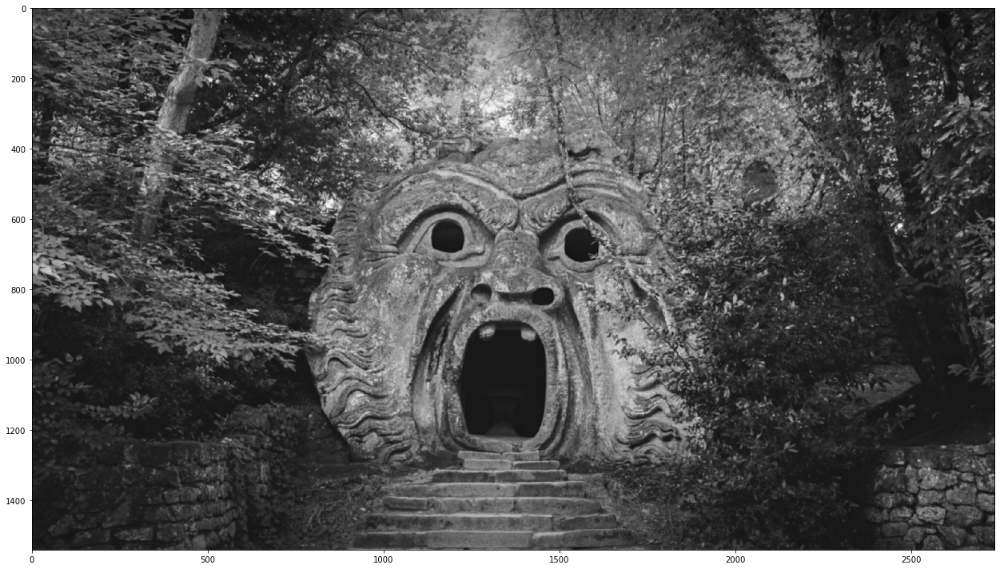

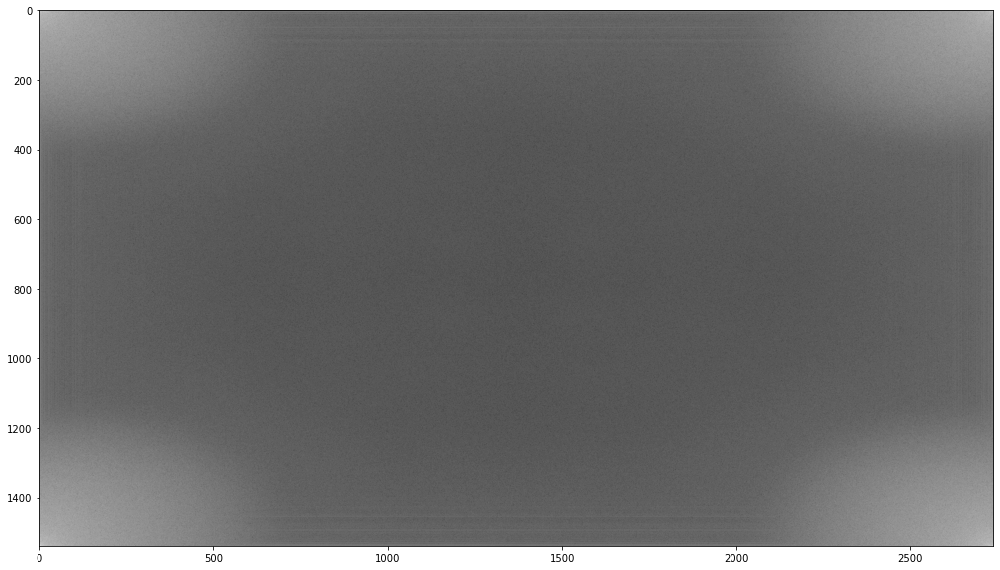

/tmp/ipykernel_2915/1561691060.py:28: DeprecationWarning: `np.float` is a deprecated alias for the builtin `float`. To silence this warning, use `float` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.float64` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  filter_HP = np.zeros(image.shape, np.float)


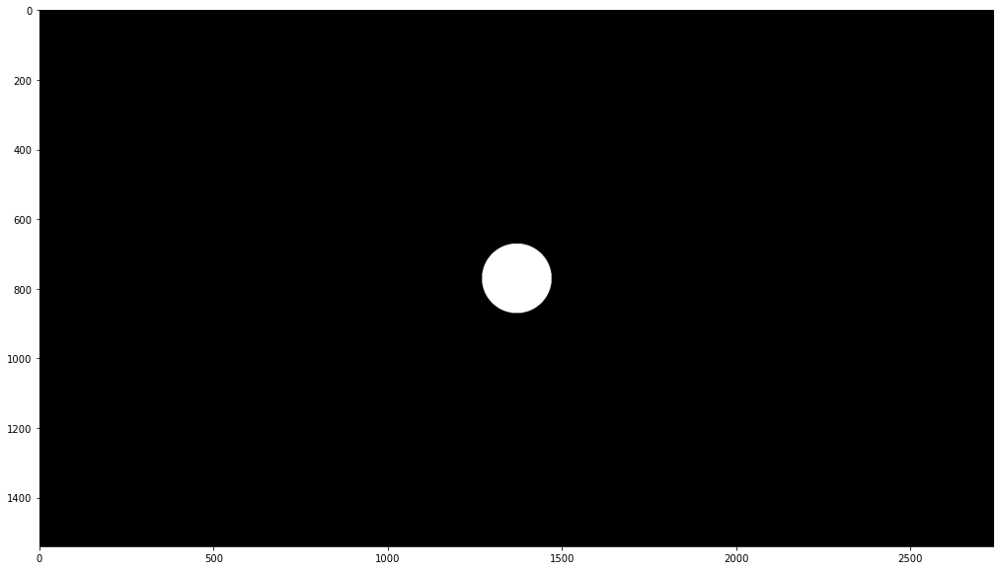

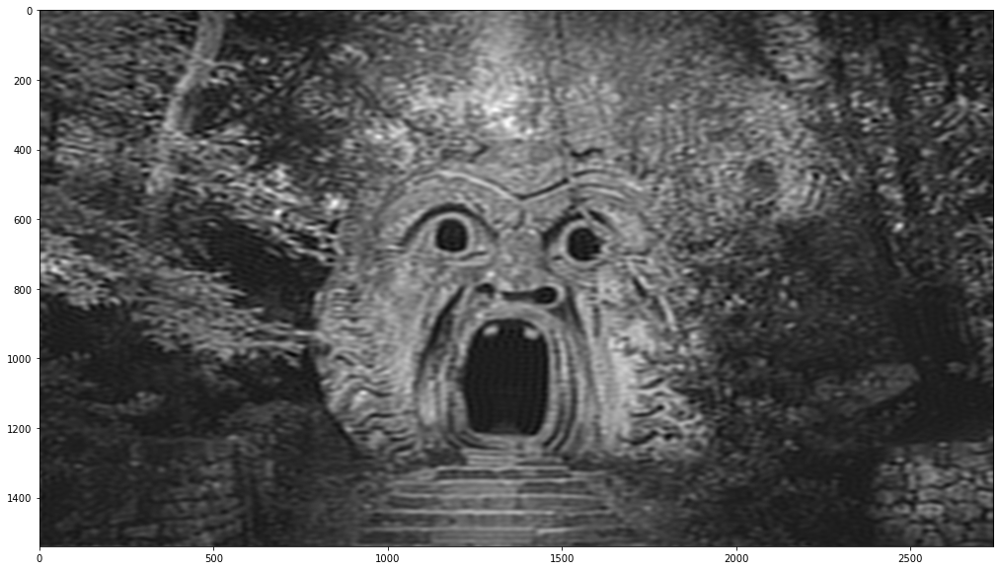

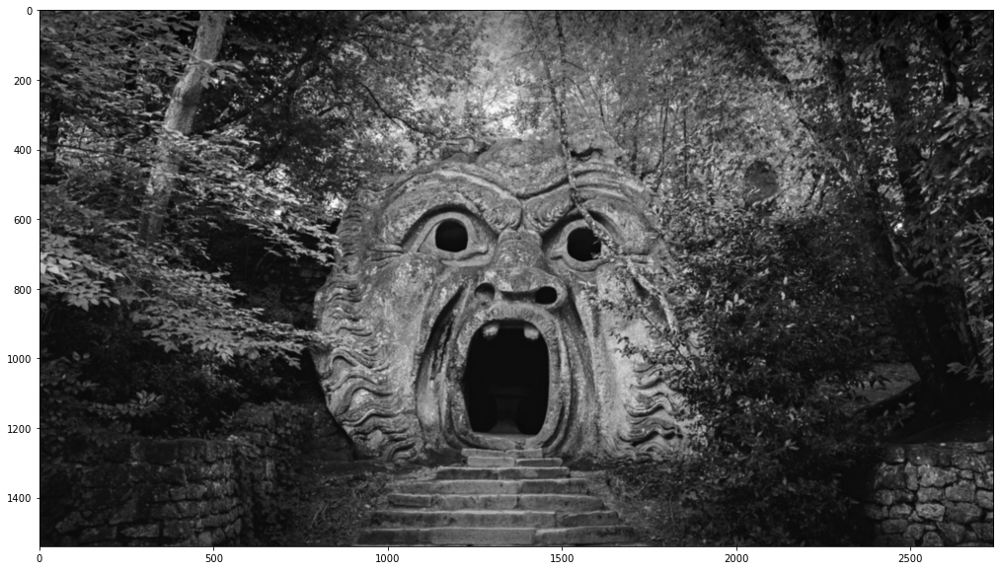

In [286]:
# import our needed libraries
import cv2 
import numpy as np
import matplotlib.pyplot as plt
import skimage.io as skio
plt.rcParams['figure.figsize'] = (20, 10)

# read our image
image = cv2.imread('OrcusMouth-blured.jpg')
image = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
skio.imshow(image)
plt.show()

# fft of our image
image_fft = np.fft.fft2(image)
image_fft_amplitude = np.log(np.abs(image_fft))
image_fft_amplitude_normalized = image_fft_amplitude - np.min(image_fft_amplitude)
image_fft_amplitude_normalized /= np.max(image_fft_amplitude_normalized)
plt.imshow(image_fft_amplitude_normalized, cmap='gray')
result_15 = np.float32(image_fft_amplitude_normalized)
result_15 = cv2.cvtColor(result_15, cv2.COLOR_RGB2BGR)
cv2.imwrite('result_15.jpg', result_15)
plt.show()

# define our High pass filter
r = 100 # high pass radius
r = r ** 2
filter_HP = np.zeros(image.shape, np.float)
moux = int(image.shape[0] / 2)
mouy = int(image.shape[1] / 2)
for i in range(image.shape[0]):
    for j in range(image.shape[1]):
        if (i - moux) ** 2 + (j - mouy) ** 2 < r:
            filter_HP[i, j] = 1
        else:
            filter_HP[i, j] = 0 
            
plt.imshow(filter_HP, cmap='gray')
plt.show()
result_19 = np.float32(filter_HP)
result_19 = cv2.cvtColor(result_16, cv2.COLOR_RGB2BGR)
cv2.imwrite('result_19.jpg', result_19)

plt.figure()
shifted_image_fft = np.fft.fftshift(image_fft)
filtered_image_fft = shifted_image_fft * filter_HP
fil_im_ishifted = np.fft.ifftshift(filtered_image_fft)
fil_im = np.fft.ifft2(fil_im_ishifted)
fil_im = np.real(fil_im)
plt.imshow(fil_im,cmap='gray')
result_20 = np.float32(fil_im)
result_20 = cv2.cvtColor(result_17, cv2.COLOR_RGB2BGR)
cv2.imwrite('result_20.jpg', result_20)
plt.show()

plt.figure()
plt.imshow(last_processed_image, cmap='gray')
result_21 = np.float32(last_processed_image)
result_21 = cv2.cvtColor(result_18, cv2.COLOR_RGB2BGR)
cv2.imwrite('result_21.jpg', result_21)
plt.show()

r mean :  96.22029806652057
g mean :  34.48899322218832
b mean :  17.819945074759357
r mean :  27.646375072817555
g mean :  104.36455611343818
b mean :  19.32072757450507


/home/ehasn/.local/lib/python3.10/site-packages/skimage/io/_plugins/matplotlib_plugin.py:150: UserWarning: Low image data range; displaying image with stretched contrast.
  lo, hi, cmap = _get_display_range(image)


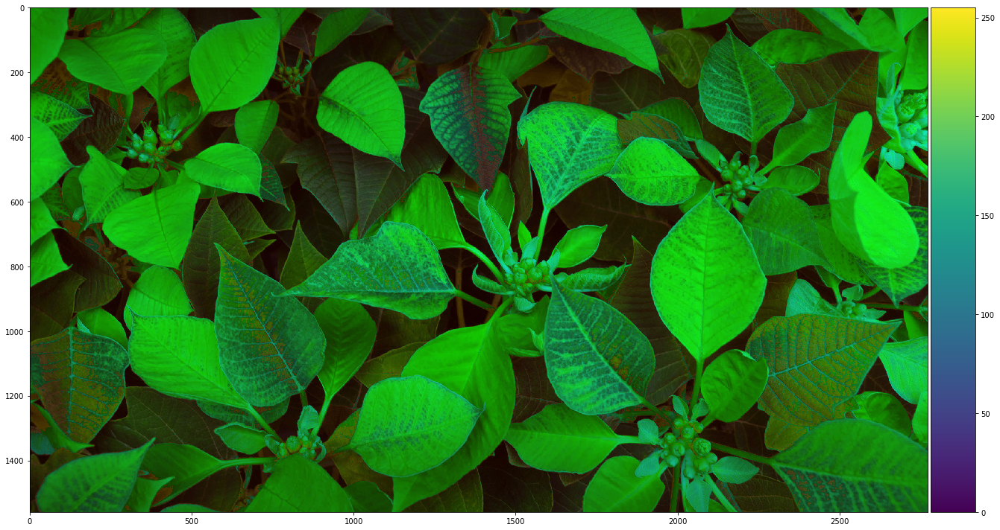

True

In [288]:
# import our needed libraries
import cv2 
import numpy as np
import matplotlib.pyplot as plt
import skimage.io as skio

# define our needed function
def power_law_transformation(image, y=0.6):    
    trnsf = 255 * (image / 255)**y
    return trnsf.astype(int)

# read our image
image = cv2.imread('Poinsettia.jpg')
image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)

# seperate our r, g, b channels
image_r = image[:, :, 0]
image_g = image[:, :, 1]
image_b = image[:, :, 2]

# check mean of every chanel
print("r mean : ", np.mean(image_r))
print("g mean : ", np.mean(image_g))
print("b mean : ", np.mean(image_b))

# main process
tre = 55
image_g = np.maximum(image_g, image_r)
image_g = image_g.astype(int) 
image_r[image_r > tre] = 0 

# change r, b chanel
image_r = image_r + 20
image_b = power_law_transformation(image_b, 0.95)

# create final image
image_final = np.dstack([image_r, image_g, image_b]).astype(int)

# check mean of every chanel after these changes
print('r mean : ', np.mean(image_r))
print('g mean : ', np.mean(image_g))
print('b mean : ', np.mean(image_b))

# show final image
skio.imshow(image_final)
skio.show()

# save our result
result_22 = np.float32(image_final)
result_22 = cv2.cvtColor(result_22, cv2.COLOR_RGB2BGR)
cv2.imwrite('result_22.jpg', result_22)